In [28]:
import multiprocessing as mp 
import random
import numpy as np
import osmnx as ox
import pandas as pd

np.random.seed(63)


#Gp = ox.projection.project_graph(G)

In [29]:
from traffix import *
import networkx as nx

In [106]:
G = ox.graph.graph_from_point((37.79, -122.41), dist=750, network_type="drive")

# Get the edges that form cycles
i = 0
while not nx.is_directed_acyclic_graph(G):
    i += 1
    edges_to_remove = list(nx.find_cycle(G, orientation="original"))
    G.remove_edges_from(edges_to_remove)
    if i == 1000:
        print("i")
        break
        
components = list(nx.weakly_connected_components(G))

# Select the largest weakly connected component
largest_component = max(components, key=len)

# Create a new graph with only this component
G_new = G.subgraph(largest_component).copy()

G.remove_nodes_from(list(nx.isolates(G_new)))

# Check if the new graph is weakly connected
print(nx.is_weakly_connected(G_new)) 
print(nx.is_directed_acyclic_graph(G_new))

True
True


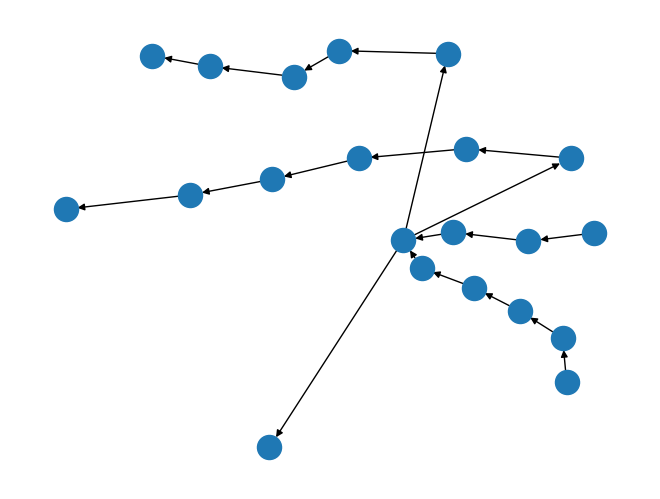

In [108]:
nx.draw(G_new)

In [109]:
nodes, edges = ox.graph_to_gdfs(G_new)

In [110]:
nodes

,y,x,highway,street_count,geometry
osmid,,,,,
65336961,37.794065,-122.407914,traffic_signals,4,POINT (-122.40791 37.79407)
386885670,37.788377,-122.407772,NaN,3,POINT (-122.40777 37.78838)
6319217960,37.790156,-122.408854,traffic_signals,4,POINT (-122.40885 37.79016)
6319217961,37.791087,-122.409044,traffic_signals,4,POINT (-122.40904 37.79109)
6319217963,37.792044,-122.409235,traffic_signals,4,POINT (-122.40924 37.79204)
6319217969,37.792056,-122.409143,traffic_signals,4,POINT (-122.40914 37.79206)
6319217970,37.791098,-122.408952,traffic_signals,4,POINT (-122.40895 37.7911)
65328705,37.791505,-122.405760,traffic_signals,4,POINT (-122.40576 37.7915)
65295311,37.792050,-122.409184,traffic_signals,4,POINT (-122.40918 37.79205)


In [112]:
len(nodes)

21

In [111]:
edges = edges.reset_index()
edges

,u,v,key,osmid,highway,lanes,name,oneway,reversed,length,geometry,maxspeed,tunnel,access
0,65336961,65336959,0,461084154,tertiary,2,Clay Street,True,False,95.432133,"LINESTRING (-122.40791 37.79407, -122.40783 37...",NaN,NaN,NaN
1,6319217960,65303544,0,674757879,tertiary,NaN,Powell Street,True,False,105.956068,"LINESTRING (-122.40885 37.79016, -122.40884 37...",25 mph,NaN,NaN
2,6319217961,6319217960,0,674757880,tertiary,NaN,Powell Street,True,False,104.816723,"LINESTRING (-122.40904 37.79109, -122.40903 37...",25 mph,NaN,NaN
3,6319217963,6319217961,0,674757881,tertiary,NaN,Powell Street,True,False,107.724096,"LINESTRING (-122.40924 37.79204, -122.40923 37...",25 mph,NaN,NaN
4,6319217969,65307381,0,"[513676827, 674757884]",tertiary,1,Powell Street,True,False,106.869190,"LINESTRING (-122.40914 37.79206, -122.40915 37...",25 mph,NaN,NaN
5,6319217970,6319217969,0,674757885,tertiary,NaN,Powell Street,True,False,107.757099,"LINESTRING (-122.40895 37.7911, -122.40897 37....",25 mph,NaN,NaN
6,65328705,65352435,0,329596844,secondary,2,Pine Street,True,False,142.282397,"LINESTRING (-122.40576 37.7915, -122.40583 37....",25 mph,NaN,NaN
7,65332833,65336961,0,91182069,tertiary,1,Clay Street,True,False,145.962639,"LINESTRING (-122.40955 37.79386, -122.40952 37...",NaN,NaN,NaN
8,6988532585,386885670,1,667569398,tertiary,1,Post Street,True,False,61.587465,"LINESTRING (-122.40843 37.78829, -122.40841 37...",NaN,NaN,NaN
9,65307376,65307381,0,734004334,tertiary,2,Sacramento Street,True,False,144.937156,"LINESTRING (-122.40774 37.79319, -122.40784 37...",NaN,NaN,NaN


In [84]:
edges['length'] = max(round(edges['length'] / 50 * 50, 50)

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [93]:
edges
edges.loc[edges['length'] == 100, 'length'] = 2423
edges
edges['lanes'].fillna(1, inplace=True)
edges['lanes'] = edges['lanes'].apply(lambda x: 1 if isinstance(x, list) else x)
edges

,u,v,key,osmid,highway,lanes,name,oneway,reversed,length,geometry,maxspeed,tunnel,access
0,65336961,65336959,0,461084154,tertiary,2,Clay Street,True,False,2423.0,"LINESTRING (-122.40791 37.79407, -122.40783 37...",NaN,NaN,NaN
1,6319217960,65303544,0,674757879,tertiary,1,Powell Street,True,False,2423.0,"LINESTRING (-122.40885 37.79016, -122.40884 37...",25 mph,NaN,NaN
2,6319217961,6319217960,0,674757880,tertiary,1,Powell Street,True,False,2423.0,"LINESTRING (-122.40904 37.79109, -122.40903 37...",25 mph,NaN,NaN
3,6319217963,6319217961,0,674757881,tertiary,1,Powell Street,True,False,2423.0,"LINESTRING (-122.40924 37.79204, -122.40923 37...",25 mph,NaN,NaN
4,6319217969,65307381,0,"[513676827, 674757884]",tertiary,1,Powell Street,True,False,2423.0,"LINESTRING (-122.40914 37.79206, -122.40915 37...",25 mph,NaN,NaN
5,6319217970,6319217969,0,674757885,tertiary,1,Powell Street,True,False,2423.0,"LINESTRING (-122.40895 37.7911, -122.40897 37....",25 mph,NaN,NaN
6,65328705,65352435,0,329596844,secondary,2,Pine Street,True,False,150.0,"LINESTRING (-122.40576 37.7915, -122.40583 37....",25 mph,NaN,NaN
7,65332833,65336961,0,91182069,tertiary,1,Clay Street,True,False,150.0,"LINESTRING (-122.40955 37.79386, -122.40952 37...",NaN,NaN,NaN
8,6988532585,386885670,1,667569398,tertiary,1,Post Street,True,False,50.0,"LINESTRING (-122.40843 37.78829, -122.40841 37...",NaN,NaN,NaN
9,65307376,65307381,0,734004334,tertiary,2,Sacramento Street,True,False,150.0,"LINESTRING (-122.40774 37.79319, -122.40784 37...",NaN,NaN,NaN


In [18]:
import importlib
from traffix import *
import multiprocessing as mp 
import random
import numpy as np
import osmnx as ox
import pandas as pd
import networkx as nx


def irl_to_traffix_model(coordinates, radius):
    """
    coordinates - tuple for x and y coordinates
    radius - how large of an area you want to map
    The maximum number of nodes it will plot is 25. It will raise an Assertion error if the inputted area
    is too large, asking the user to reduce.
    """
    # Load in OSMNX graph
    G_raw = ox.graph.graph_from_point(coordinates, dist=radius, network_type="drive")
    
    # Graph reduction to acyclic graph for modeling purposes, remove isolated nodes, get weakly-connected graph
    while not nx.is_directed_acyclic_graph(G_raw):
        edges_to_remove = list(nx.find_cycle(G_raw, orientation="original"))
        G_raw.remove_edges_from(edges_to_remove)
    components = list(nx.weakly_connected_components(G_raw))
    largest_component = max(components, key=len)
    G = G_raw.subgraph(largest_component).copy()
    G.remove_nodes_from(list(nx.isolates(G)))

    # Check for weakly-connected, directed acyclic, size of graph is feasible
    assert nx.is_weakly_connected(G), "Invalid Area. Resulting map is not weakly connected/not present."
    assert nx.is_directed_acyclic_graph(G), "Invalid Area. Modifications did not produce a DAG. Please choose a different area."
    assert len(G.nodes) <= 25, "Please reduce the size of the requested region (lower radius, choose less dense area)."
    
    # Get positions based on node coordinates for more accurate visualization (using geo Pandas dataframes)
    nodes, edges = ox.graph_to_gdfs(G)
    nodes = nodes.reset_index()
    edges = edges.reset_index()
    # Normalize coords
    nodes['xpos'] = (nodes['x'] - nodes['x'].min()) / (nodes['x'].max() - nodes['x'].min())
    nodes['ypos'] = (nodes['y'] - nodes['y'].min()) / (nodes['y'].max() - nodes['y'].min())
    # Round edge lengths to nearest multiple of 50, nonzero (for seg_len purposes in traffix.py)
    edges['length'] = round(edges['length'] / 50, 0) * 50
    edges.loc[edges['length'] == 0, 'length'] = 50
    # Fill in lane NaN and invalid values (e.g. lists) with 1
    edges['lanes'].fillna(1, inplace=True)
    edges['lanes'] = edges['lanes'].apply(lambda x: 1 if isinstance(x, list) else x)
    edges['lanes'] = edges['lanes'].astype(int)
    
    # Instantiation of TraffiX model
    model = Map(confirmation_messages = False)
    
    for node_row in range(len(nodes)):
        name = nodes.loc[node_row, 'osmid']
        position = (nodes.loc[node_row, 'xpos'], nodes.loc[node_row, 'ypos'])
        model.add_inter(label=name, pos=position)
        
    #m.add_road(1, 2, dt=1, speed_limit=50, length=100, lanes=1, num_cars=0)
    for edge_row in range(len(edges)):
        start = edges.loc[edge_row, 'u']
        end = edges.loc[edge_row, 'v']
        speed_limit = 50
        # this is a shortcoming of the osmnx dataset. Speed limits are often not listed for road segments so we just make this assumption here.
        # really, this model makes a lot of gross assumptions, so this comparatively isn't too gross.
        length = edges.loc[edge_row, 'length']
        lanes = edges.loc[edge_row, 'lanes']
        model.add_road(start, end, dt=1, speed_limit=speed_limit, length=length, lanes=lanes, num_cars=0)
    
    print(f"""
    Uncompiled model of IRL road network at {coordinates} with radius {radius} returned.
    Please declare input nodes and initialize number of cars to sinks before compilation.
    The current summary of the graph (with sinks) and a sketch of the graph are below.
    """)
    model.get_summary()
    nx.draw(model.G, pos=model.node_positions)
    
    # Display root nodes for potential inputs the user can provide
    in_degrees = dict(model.G.in_degree(model.G.nodes))
    roots = [node for node in in_degrees if in_degrees[node] == 0]
    print(f"""
    For reference, the root nodes that can serve as potential inputs are:
    {roots}
    Initialize inputs with:
    - .declare_inflow_node(source_node (its name), initial_cars_to_sinks (dictionary, sinks are keys, num_cars are values))
    """)
    
    return model


    Uncompiled model of IRL road network at (37.79, -122.41) with radius 750 returned.
    Please declare input nodes and initialize number of cars to sinks before compilation.
    The current summary of the graph (with sinks) and a sketch of the graph are below.
    

        Resources Used:
        - Total length of road used: 2850.0 units
        - Total number of lanes: 24
        Key Nodes:
        - Inputs: []
        - Sinks: [386885670, 65295311, 65307368]
        - Sink destination amounts/Total traffic: {}
        

    For reference, the root nodes that can serve as potential inputs are:
    [6378899319, 65319933]
    Initialize inputs with:
    - .declare_inflow_node(source_node (its name), initial_cars_to_sinks (dictionary, sinks are keys, num_cars are values))
    


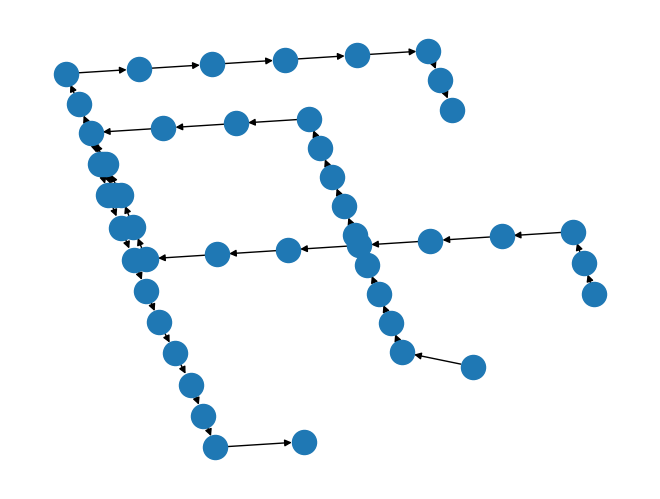

In [19]:
model = irl_to_traffix_model(coordinates=(37.79, -122.41), radius=750)

In [20]:
model.declare_inflow_node(6378899319, {386885670: 40, 65295311: 40, 65307368: 40})
model.declare_inflow_node(65319933, {386885670: 40, 65295311: 40, 65307368: 40})

model.simulation_check_compile()
                          
#Sinks: [386885670, 65295311, 65307368]
#Roots: 65319933

In [22]:
from visualization import *

simulate(model)

151it [01:49,  1.38it/s]                         
